# US- Accidents - Exploratory Data Analysis


## Data Download

In [ ]:
 !pip install -q kaggle

In [ ]:
from google.colab import files

files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"rahulb2205","key":"abd5b6f30c53a09523eee5759e55d330"}'}

In [ ]:
! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/

In [ ]:
 ! chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!kaggle datasets download -d sobhanmoosavi/us-accidents

 98% 294M/299M [00:03<00:00, 82.1MB/s]
100% 299M/299M [00:03<00:00, 82.1MB/s]


In [ ]:
! unzip us-accidents.zip

Archive:  us-accidents.zip
  inflating: US_Accidents_Dec20.csv  


## Import Libraries

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')

In [ ]:
df = pd.read_csv('US_Accidents_Dec20.csv')

## Data Preparation and Cleaning
1. Load the file using Pandas
2. Look at some information about the data & the columns
3. Fix any missing or incorrect values

In [ ]:
df.head()

,ID,Source,TMC,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Description,Number,Street,Side,City,County,State,Zipcode,Country,Timezone,Airport_Code,Weather_Timestamp,Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Direction,Wind_Speed(mph),Precipitation(in),Weather_Condition,Amenity,Bump,Crossing,Give_Way,Junction,No_Exit,Railway,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
0,A-1,MapQuest,201.0,3,2016-02-08 05:46:00,2016-02-08 11:00:00,39.865147,-84.058723,NaN,NaN,0.01,Right lane blocked due to accident on I-70 Eas...,NaN,I-70 E,R,Dayton,Montgomery,OH,45424,US,US/Eastern,KFFO,2016-02-08 05:58:00,36.9,NaN,91.0,29.68,10.0,Calm,NaN,0.02,Light Rain,False,False,False,False,False,False,False,False,False,False,False,False,False,Night,Night,Night,Night
1,A-2,MapQuest,201.0,2,2016-02-08 06:07:59,2016-02-08 06:37:59,39.928059,-82.831184,NaN,NaN,0.01,Accident on Brice Rd at Tussing Rd. Expect del...,2584.0,Brice Rd,L,Reynoldsburg,Franklin,OH,43068-3402,US,US/Eastern,KCMH,2016-02-08 05:51:00,37.9,NaN,100.0,29.65,10.0,Calm,NaN,0.00,Light Rain,False,False,False,False,False,False,False,False,False,False,False,False,False,Night,Night,Night,Day
2,A-3,MapQuest,201.0,2,2016-02-08 06:49:27,2016-02-08 07:19:27,39.063148,-84.032608,NaN,NaN,0.01,Accident on OH-32 State Route 32 Westbound at ...,NaN,State Route 32,R,Williamsburg,Clermont,OH,45176,US,US/Eastern,KI69,2016-02-08 06:56:00,36.0,33.3,100.0,29.67,10.0,SW,3.5,NaN,Overcast,False,False,False,False,False,False,False,False,False,False,False,True,False,Night,Night,Day,Day
3,A-4,MapQuest,201.0,3,2016-02-08 07:23:34,2016-02-08 07:53:34,39.747753,-84.205582,NaN,NaN,0.01,Accident on I-75 Southbound at Exits 52 52B US...,NaN,I-75 S,R,Dayton,Montgomery,OH,45417,US,US/Eastern,KDAY,2016-02-08 07:38:00,35.1,31.0,96.0,29.64,9.0,SW,4.6,NaN,Mostly Cloudy,False,False,False,False,False,False,False,False,False,False,False,False,False,Night,Day,Day,Day
4,A-5,MapQuest,201.0,2,2016-02-08 07:39:07,2016-02-08 08:09:07,39.627781,-84.188354,NaN,NaN,0.01,Accident on McEwen Rd at OH-725 Miamisburg Cen...,NaN,Miamisburg Centerville Rd,R,Dayton,Montgomery,OH,45459,US,US/Eastern,KMGY,2016-02-08 07:53:00,36.0,33.3,89.0,29.65,6.0,SW,3.5,NaN,Mostly Cloudy,False,False,False,False,False,False,False,False,False,False,False,True,False,Day,Day,Day,Day


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4232541 entries, 0 to 4232540
Data columns (total 49 columns):
 #   Column                 Dtype  
---  ------                 -----  
 0   ID                     object 
 1   Source                 object 
 2   TMC                    float64
 3   Severity               int64  
 4   Start_Time             object 
 5   End_Time               object 
 6   Start_Lat              float64
 7   Start_Lng              float64
 8   End_Lat                float64
 9   End_Lng                float64
 10  Distance(mi)           float64
 11  Description            object 
 12  Number                 float64
 13  Street                 object 
 14  Side                   object 
 15  City                   object 
 16  County                 object 
 17  State                  object 
 18  Zipcode                object 
 19  Country                object 
 20  Timezone               object 
 21  Airport_Code           object 
 22  Weather_Timestamp 

In [ ]:
missing = (df.isnull().sum().sort_values(ascending=False)/len(df))*100

(<matplotlib.axes._subplots.AxesSubplot at 0x7f06bb9b3890>,
 End_Lat              64.180760
 End_Lng              64.180760
 Number               63.506745
 Precipitation(in)    48.802575
 Wind_Chill(F)        44.795809
 TMC                  35.819240
 Wind_Speed(mph)      11.324781
 Visibility(mi)        2.331176
 Weather_Condition     2.324443
 Humidity(%)           2.255548
 Temperature(F)        2.124020
 Wind_Direction        1.975433
 Pressure(in)          1.804684
 Weather_Timestamp     1.480057
 dtype: float64)

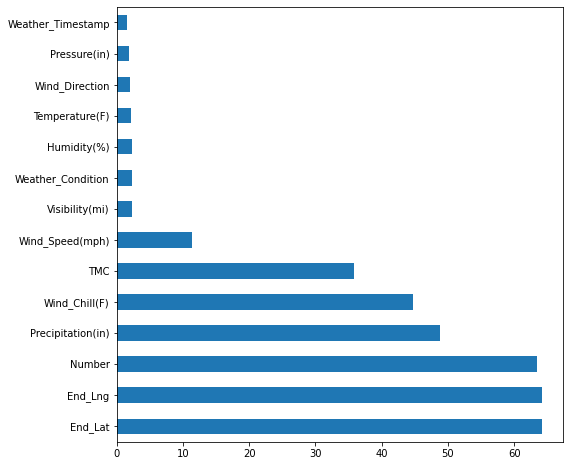

In [ ]:
missing[missing >= 1].plot(kind='barh', figsize=(8,8)), missing[missing >= 1]

Removing less important columns
1. ID
2. TMC
3. Number
4. End_Lng
5. End_Lat


In [ ]:
remove_col = ["ID", "TMC", "Number", "End_Lng", "End_Lat"]

In [ ]:
df.drop(columns=remove_col, axis=1, inplace=True)

## Exploratory Data Analysis & Visualization

In [ ]:
df.head(2)

,Source,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,Distance(mi),Description,Street,Side,City,County,State,Zipcode,Country,Timezone,Airport_Code,Weather_Timestamp,Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Direction,Wind_Speed(mph),Precipitation(in),Weather_Condition,Amenity,Bump,Crossing,Give_Way,Junction,No_Exit,Railway,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
0,MapQuest,3,2016-02-08 05:46:00,2016-02-08 11:00:00,39.865147,-84.058723,0.01,Right lane blocked due to accident on I-70 Eas...,I-70 E,R,Dayton,Montgomery,OH,45424,US,US/Eastern,KFFO,2016-02-08 05:58:00,36.9,NaN,91.0,29.68,10.0,Calm,NaN,0.02,Light Rain,False,False,False,False,False,False,False,False,False,False,False,False,False,Night,Night,Night,Night
1,MapQuest,2,2016-02-08 06:07:59,2016-02-08 06:37:59,39.928059,-82.831184,0.01,Accident on Brice Rd at Tussing Rd. Expect del...,Brice Rd,L,Reynoldsburg,Franklin,OH,43068-3402,US,US/Eastern,KCMH,2016-02-08 05:51:00,37.9,NaN,100.0,29.65,10.0,Calm,NaN,0.00,Light Rain,False,False,False,False,False,False,False,False,False,False,False,False,False,Night,Night,Night,Day


### Cities


In [ ]:
cities = df.City.value_counts()

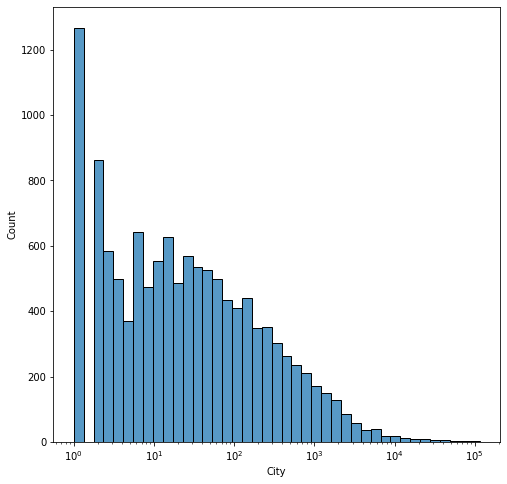

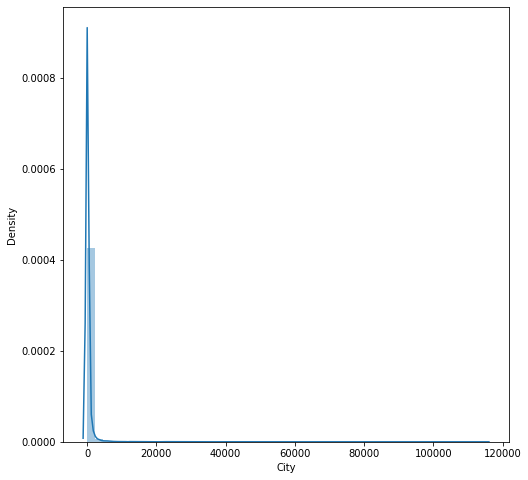

In [ ]:
plt.figure(figsize=(8,8))
sns.histplot(cities,log_scale=True)
plt.show()

plt.figure(figsize=(8,8))
sns.distplot(cities)
plt.show()

In [ ]:
cities.max()

114905

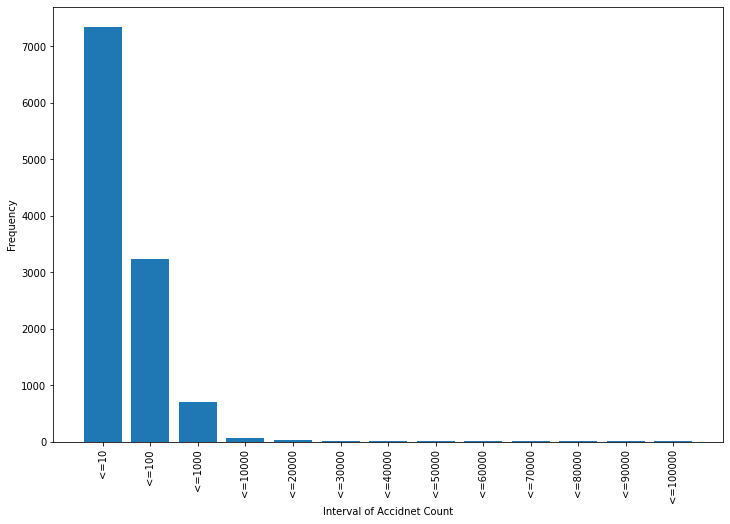

In [ ]:
val = [10,100,1000,10000,20000,30000,40000,50000,60000,70000,80000,90000,100000]
data = {"No of Accidents":["<=10","<=100","<=1000","<=10000","<=20000","<=30000","<=40000","<=50000","<=60000","<=70000","<=80000","<=90000","<=100000"],
        "No. of Cities":[len(cities[cities>i]) for i in val]}
plt.figure(figsize=(12,8))
plt.bar(pd.DataFrame(data)['No of Accidents'],pd.DataFrame(data)['No. of Cities'])
plt.xticks(rotation=90)
plt.xlabel('Interval of Accidnet Count')
plt.ylabel('Frequency')
plt.show()

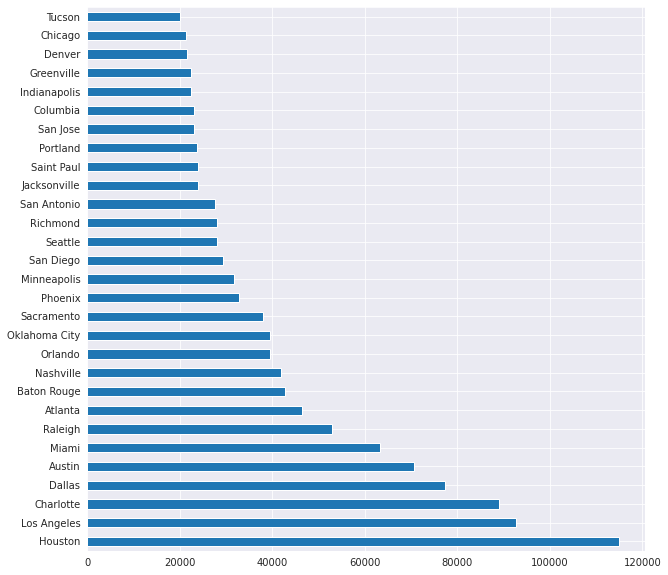

(99.76326530612245, 0.23673469387755103)

In [ ]:
cities[cities>20000].plot(kind='barh',figsize=(10,10))
plt.show()
(len(cities[cities<20000])/len(cities))*100,(len(cities[cities>20000])/len(cities))*100

*   99.76% of the cities have less than 20,000 accidents
*   0.24% of the cities have accidents over 20,000



### States

In [ ]:
states = df.State.value_counts()

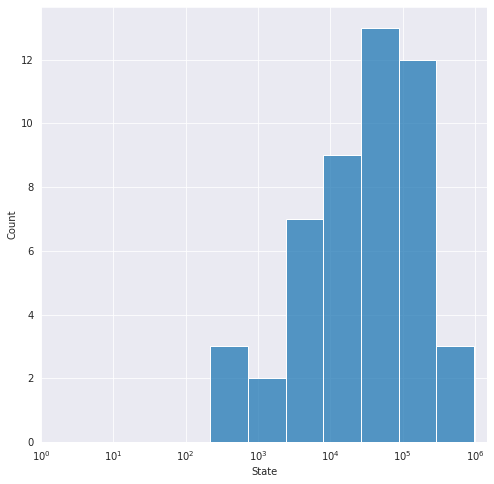

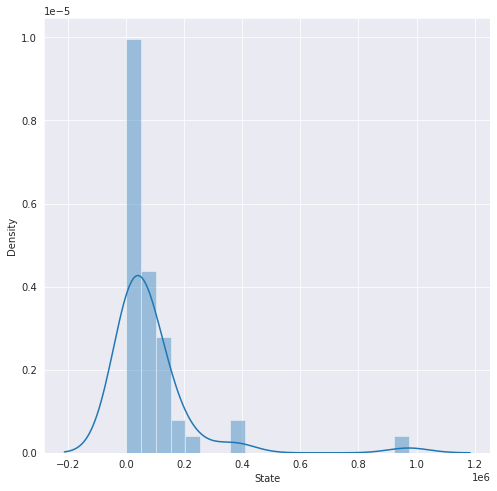

In [ ]:
plt.figure(figsize=(8,8))
sns.histplot(states,log_scale=True)
plt.xticks([1e0,1e1,1e2,1e3,1e4,1e5,1e6])
plt.show()

plt.figure(figsize=(8,8))
sns.distplot(states)
plt.show()

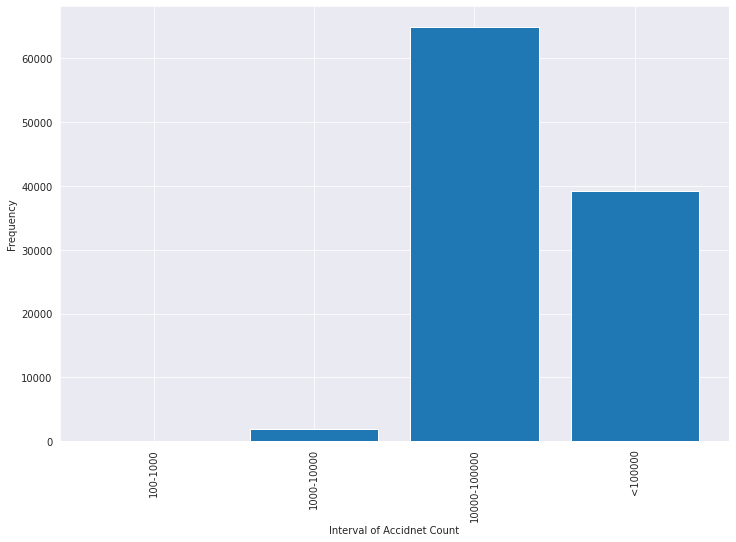

In [ ]:
val1 = [100,1000,10000,100000,1000000]
data1 = {"Interval":["100-1000","1000-10000",'10000-100000',"<100000"],
         "Value":[states[(states<val[i+1]) & (states>val[i])].sum() for i in range(len(val1)-1)]}
plt.figure(figsize=(12,8))
plt.bar(pd.DataFrame(data1)['Interval'],pd.DataFrame(data1)['Value'])
plt.xticks(rotation=90)
plt.xlabel('Interval of Accidnet Count')
plt.ylabel('Frequency')
plt.show()

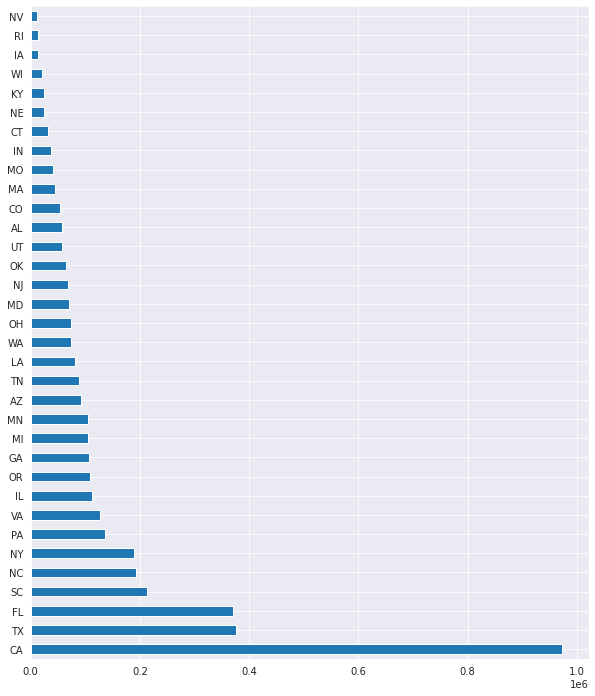

(73.46938775510205, 26.53061224489796)

In [ ]:
states[states>10000].plot(kind='barh', figsize=(10,12))
plt.show()
(len(states[states<100000])/len(states))*100,(len(states[states>100000])/len(states))*100

*   73.5% of the states have accidents less than a 100K
*   26.5% of the sattes have accidents more than 100k

### Strat Time

In [ ]:
df.Start_Time = pd.to_datetime(df.Start_Time)
df.End_Time = pd.to_datetime(df.End_Time)

In [ ]:
df.head(2)

,Source,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,Distance(mi),Description,Street,Side,City,County,State,Zipcode,Country,Timezone,Airport_Code,Weather_Timestamp,Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Direction,Wind_Speed(mph),Precipitation(in),Weather_Condition,Amenity,Bump,Crossing,Give_Way,Junction,No_Exit,Railway,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
0,MapQuest,3,2016-02-08 05:46:00,2016-02-08 11:00:00,39.865147,-84.058723,0.01,Right lane blocked due to accident on I-70 Eas...,I-70 E,R,Dayton,Montgomery,OH,45424,US,US/Eastern,KFFO,2016-02-08 05:58:00,36.9,NaN,91.0,29.68,10.0,Calm,NaN,0.02,Light Rain,False,False,False,False,False,False,False,False,False,False,False,False,False,Night,Night,Night,Night
1,MapQuest,2,2016-02-08 06:07:59,2016-02-08 06:37:59,39.928059,-82.831184,0.01,Accident on Brice Rd at Tussing Rd. Expect del...,Brice Rd,L,Reynoldsburg,Franklin,OH,43068-3402,US,US/Eastern,KCMH,2016-02-08 05:51:00,37.9,NaN,100.0,29.65,10.0,Calm,NaN,0.00,Light Rain,False,False,False,False,False,False,False,False,False,False,False,False,False,Night,Night,Night,Day


In [ ]:
sns.set_style('darkgrid')

#### Hourly

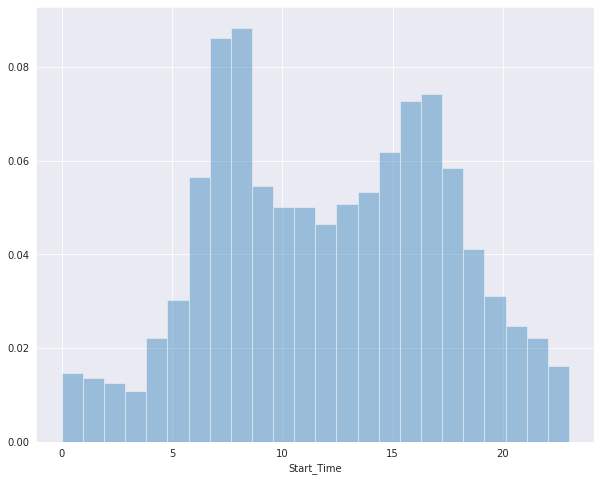

In [ ]:
plt.figure(figsize=(10,8))
sns.distplot(df.Start_Time.dt.hour, bins=24, kde=False, norm_hist=True)
plt.show()

*   A high percentage of accidents occur between 6 am to 10 am (probably people in a hurry to get to work)
*   Next higest percentage is 3 pm to 6 pm.





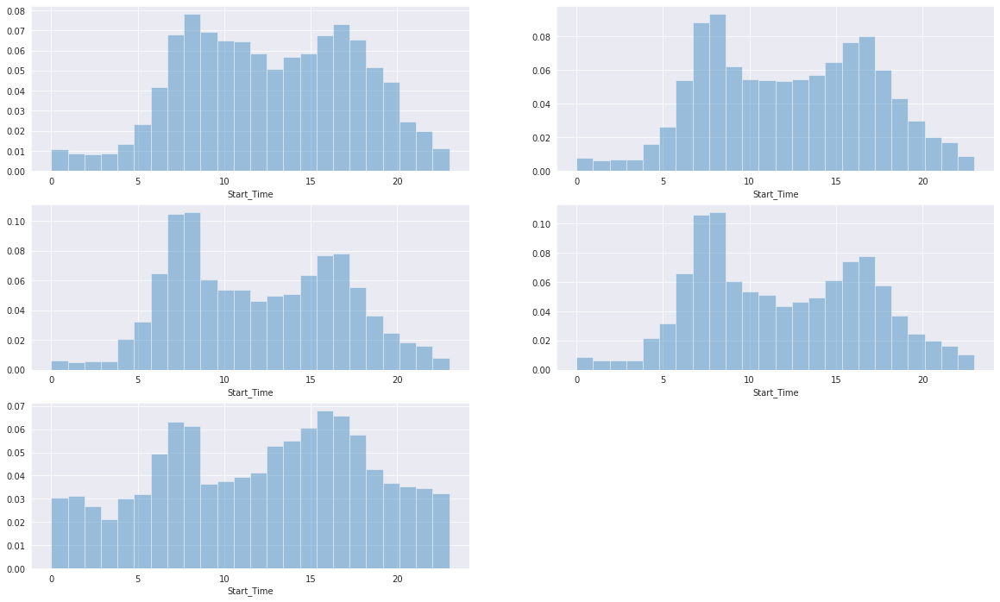

In [ ]:
fig = plt.figure(figsize=(20,12))
fig.add_subplot(3,2,1)
sns.distplot(df.Start_Time[df.Start_Time.dt.year==2016].dt.hour, bins=24, kde=False, norm_hist=True)
fig.add_subplot(3,2,2)
sns.distplot(df.Start_Time[df.Start_Time.dt.year==2017].dt.hour, bins=24, kde=False, norm_hist=True)
fig.add_subplot(3,2,3)
sns.distplot(df.Start_Time[df.Start_Time.dt.year==2018].dt.hour, bins=24, kde=False, norm_hist=True)
fig.add_subplot(3,2,4)
sns.distplot(df.Start_Time[df.Start_Time.dt.year==2019].dt.hour, bins=24, kde=False, norm_hist=True)
fig.add_subplot(3,2,5)
sns.distplot(df.Start_Time[df.Start_Time.dt.year==2020].dt.hour, bins=24, kde=False, norm_hist=True)
plt.show()

*   Distribution of Hourly Accidents differ from year to year.




#### Daily

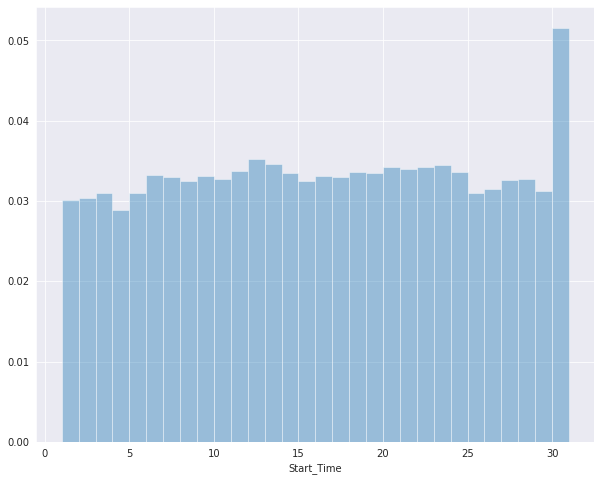

In [ ]:
plt.figure(figsize=(10,8))
sns.distplot(df.Start_Time.dt.day, bins=30, kde=False, norm_hist=True)
plt.show()

*   There is a more or less even distribution of accidents per day except for the last day of the month (considering a month is composed of 30 days)

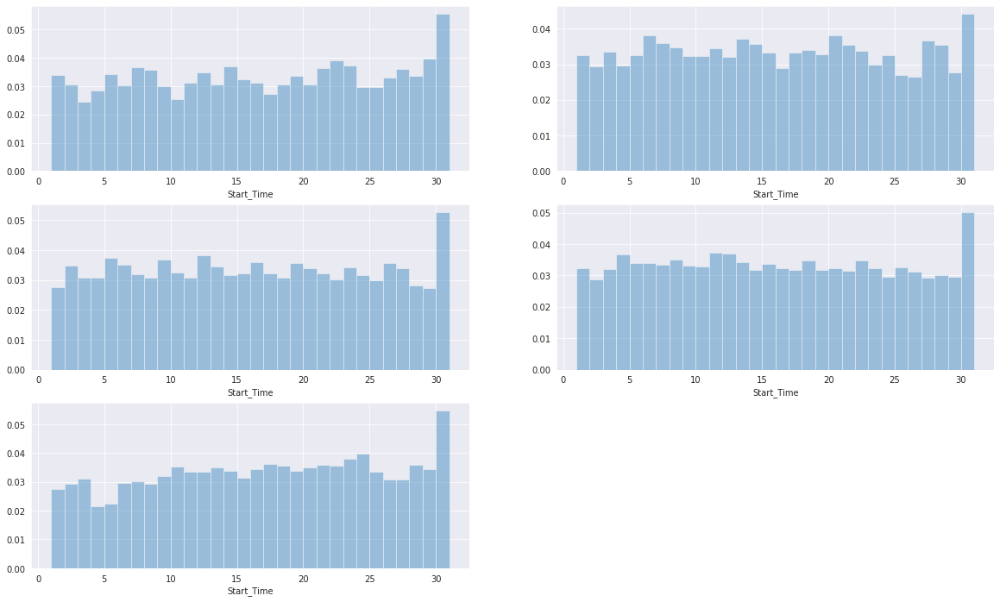

In [ ]:
fig = plt.figure(figsize=(20,12))
fig.add_subplot(3,2,1)
sns.distplot(df.Start_Time[df.Start_Time.dt.year==2016].dt.day, bins=30, kde=False, norm_hist=True)
fig.add_subplot(3,2,2)
sns.distplot(df.Start_Time[df.Start_Time.dt.year==2017].dt.day, bins=30, kde=False, norm_hist=True)
fig.add_subplot(3,2,3)
sns.distplot(df.Start_Time[df.Start_Time.dt.year==2018].dt.day, bins=30, kde=False, norm_hist=True)
fig.add_subplot(3,2,4)
sns.distplot(df.Start_Time[df.Start_Time.dt.year==2019].dt.day, bins=30, kde=False, norm_hist=True)
fig.add_subplot(3,2,5)
sns.distplot(df.Start_Time[df.Start_Time.dt.year==2020].dt.day, bins=30, kde=False, norm_hist=True)
plt.show()

*   Daily accidents distribution follow a more or less similar trend for every year


#### Monthly

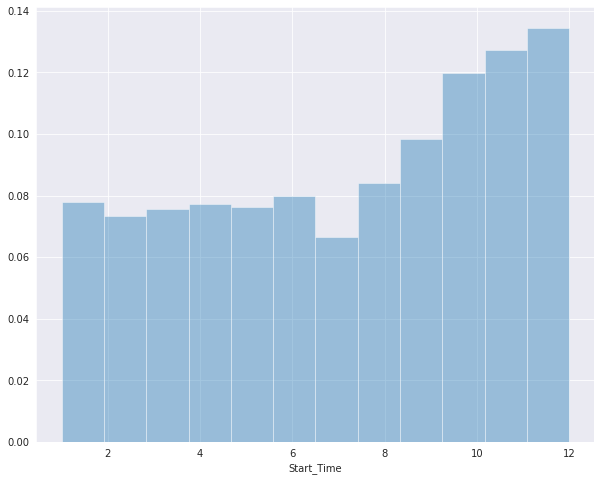

In [ ]:
plt.figure(figsize=(10,8))
sns.distplot(df.Start_Time.dt.month, bins=12, kde=False, norm_hist=True)
plt.show()



*   There seems to be a high amount of accidents taking place in the winter months (need to investigate)
*   Summer months have a low amount of accidents comparitively



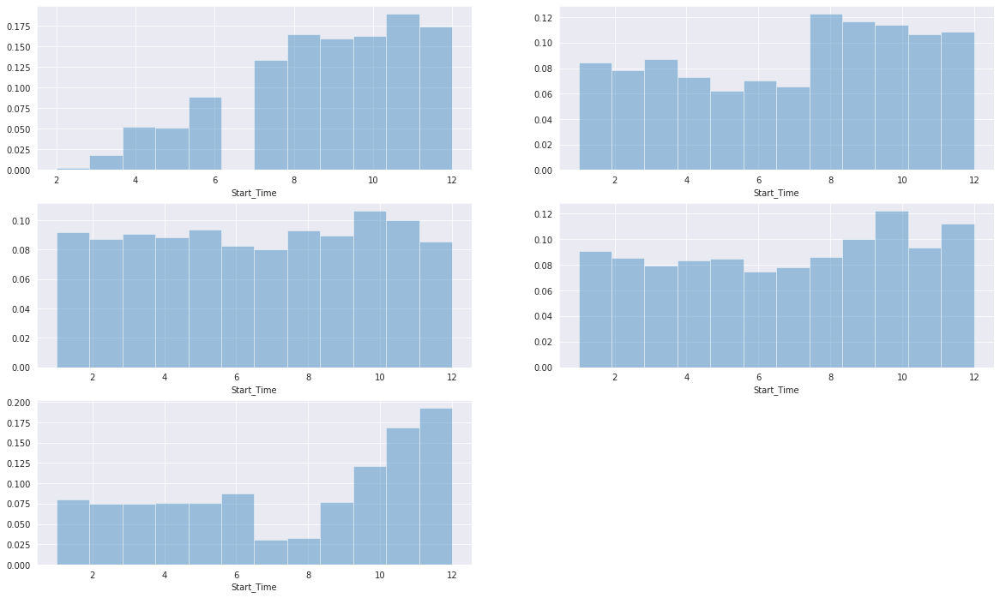

In [ ]:
fig = plt.figure(figsize=(20,12))
fig.add_subplot(3,2,1)
sns.distplot(df.Start_Time[df.Start_Time.dt.year==2016].dt.month, bins=12, kde=False, norm_hist=True)
fig.add_subplot(3,2,2)
sns.distplot(df.Start_Time[df.Start_Time.dt.year==2017].dt.month, bins=12, kde=False, norm_hist=True)
fig.add_subplot(3,2,3)
sns.distplot(df.Start_Time[df.Start_Time.dt.year==2018].dt.month, bins=12, kde=False, norm_hist=True)
fig.add_subplot(3,2,4)
sns.distplot(df.Start_Time[df.Start_Time.dt.year==2019].dt.month, bins=12, kde=False, norm_hist=True)
fig.add_subplot(3,2,5)
sns.distplot(df.Start_Time[df.Start_Time.dt.year==2020].dt.month, bins=12, kde=False, norm_hist=True)
plt.show()

*   Breaking the monthly accidents year-wise we see that the distribution of accidents is not the same, every year
*   2016 and 2017 seems to have some missing data
*   Since there are two data sources, we will check the data by breaking it down from its source


In [ ]:
bing_data=df[df.Source=='Bing']
mapquest_data=df[df.Source=='MapQuest']

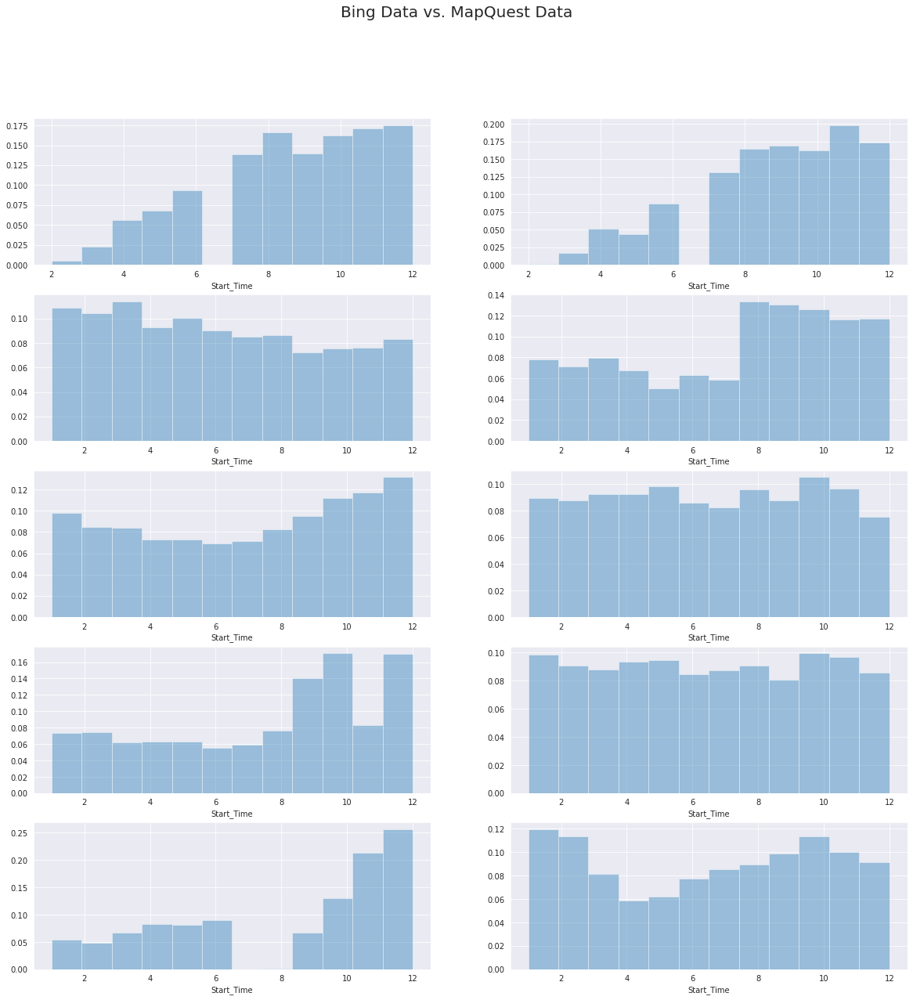

In [ ]:
fig = plt.figure(figsize=(20,20))
fig.add_subplot(5,2,1)
sns.distplot(bing_data.Start_Time[bing_data.Start_Time.dt.year==2016].dt.month, bins=12, kde=False, norm_hist=True)
fig.add_subplot(5,2,2)
sns.distplot(mapquest_data.Start_Time[mapquest_data.Start_Time.dt.year==2016].dt.month, bins=12, kde=False, norm_hist=True)
fig.add_subplot(5,2,3)
sns.distplot(bing_data.Start_Time[bing_data.Start_Time.dt.year==2017].dt.month, bins=12, kde=False, norm_hist=True)
fig.add_subplot(5,2,4)
sns.distplot(mapquest_data.Start_Time[mapquest_data.Start_Time.dt.year==2017].dt.month, bins=12, kde=False, norm_hist=True)
fig.add_subplot(5,2,5)
sns.distplot(bing_data.Start_Time[bing_data.Start_Time.dt.year==2018].dt.month, bins=12, kde=False, norm_hist=True)
fig.add_subplot(5,2,6)
sns.distplot(mapquest_data.Start_Time[mapquest_data.Start_Time.dt.year==2018].dt.month, bins=12, kde=False, norm_hist=True)
fig.add_subplot(5,2,7)
sns.distplot(bing_data.Start_Time[bing_data.Start_Time.dt.year==2019].dt.month, bins=12, kde=False, norm_hist=True)
fig.add_subplot(5,2,8)
sns.distplot(mapquest_data.Start_Time[mapquest_data.Start_Time.dt.year==2019].dt.month, bins=12, kde=False, norm_hist=True)
fig.add_subplot(5,2,9)
sns.distplot(bing_data.Start_Time[bing_data.Start_Time.dt.year==2020].dt.month, bins=12, kde=False, norm_hist=True)
fig.add_subplot(5,2,10)
sns.distplot(mapquest_data.Start_Time[mapquest_data.Start_Time.dt.year==2020].dt.month, bins=12, kde=False, norm_hist=True)
plt.suptitle('Bing Data vs. MapQuest Data',size=20)
plt.show()

*   We see that there are a lot of missing data in this dataset, mostly for Bing

### Start Lat and Start Long

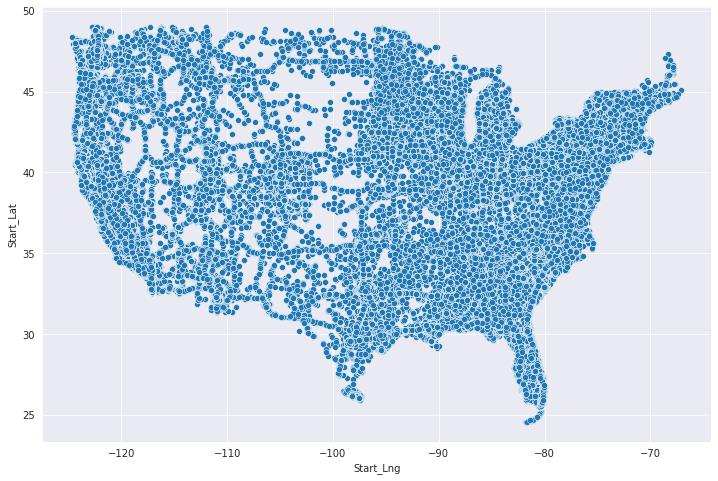

In [ ]:
plt.figure(figsize=(12,8))
sns.scatterplot(x=df.Start_Lng, y=df.Start_Lat)

In [ ]:
import folium

In [ ]:
sample_df = df.sample(10000)

In [ ]:
df_win = df[(df.Start_Time.dt.month==10) | (df.Start_Time.dt.month==11) | (df.Start_Time.dt.month==12)].sample(10000)
df_sum = df[(df.Start_Time.dt.month==5) | (df.Start_Time.dt.month==6) | (df.Start_Time.dt.month==7)].sample(10000)

In [ ]:
map_sum = folium.Map(location=[df.Start_Lat.mean(),df.Start_Lng.mean()],zoom_start=5)
for lat,lon in zip(df_sum.Start_Lat, df_sum.Start_Lng):
  folium.CircleMarker([lat,lon],fill=True,fill_opacity=0.5).add_to(map_sum)
map_sum

In [ ]:
map_win = folium.Map(location=[df.Start_Lat.mean(),df.Start_Lng.mean()],zoom_start=5)
for lat,lon in zip(df_win.Start_Lat, df_win.Start_Lng):
  folium.CircleMarker([lat,lon],fill=True,fill_opacity=0.5).add_to(map_win)
map_win

*   Coastal Areas have more accidents than other regions
*   There is no particular difference between summer accidents and winter accidents, demographically. (Most of the accidents take placce in coastal areas)

## Ask & answer questions
1.Are there more accidents in warmer or colder areas?
2. Which 5 states have the highest number of accidents?
3. How about per capita?
4. Does New York show up in the data? If yes, why is the count lower if this the most populated city.
5. Among the top 100 cities in number of accidents, which states do they belong to most frequently.
6. What time of the day are accidents most frequent in? - ANSWERED
7. Which days of the week have the most accidents?
8. Which months have the most accidents?
9. What is the trend of accidents year over year (decreasing/increasing?)
10. When is accidents per unit of traffic the highest.